In [11]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


### Download and Import Required Libraries

In [7]:
from PIL import Image
import os, sys
from sklearn import model_selection
import pandas as pd
import ast
from tqdm import tqdm
import numpy as np
import shutil

In [8]:
from pathlib import Path
import PIL.Image as Image
import cv2
import torch
import torchvision
from IPython.display import display
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline
%config InlineBackend.figure_format='retina'

In [9]:
!pip install PyYAML==5.4.1

     |████████████████████████████████| 636 kB 5.1 MB/s 
  Attempting uninstall: PyYAML
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13


In [10]:
# !pip install wandb

### Clone YOLO
Move Cursor to required Directory

In [ ]:
%cd /content/drive/MyDrive/DL_project/Dataset/kaggle-global-wheat-detection/yolo2/yolov5/
# !mkdir yolo2
# %cd ..

/content/drive/MyDrive/DL_project/Dataset/kaggle-global-wheat-detection/yolo2/yolov5


In [ ]:
# !mv yolov5/yolov5x.pt yolo2/yolov5

In [ ]:
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
!pip install -r requirements.txt  # install

Cloning into 'yolov5'...
remote: Enumerating objects: 8754, done.
remote: Counting objects: 100% (468/468), done.
remote: Compressing objects: 100% (277/277), done.
remote: Total 8754 (delta 300), reused 318 (delta 191), pack-reused 8286
Receiving objects: 100% (8754/8754), 9.67 MiB | 21.87 MiB/s, done.
Resolving deltas: 100% (6040/6040), done.
/content/yolov5
     |████████████████████████████████| 636 kB 8.4 MB/s 
  Attempting uninstall: PyYAML
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13


In [ ]:
!mv /content/yolov5 /content/drive/MyDrive

In [ ]:
%cd drive/MyDrive/DL_project/Dataset/kaggle-global-wheat-detection/yolov5

In [ ]:
!pip install -r requirements.txt  # install

### Unzip data

In [ ]:
# !unzip /content/drive/MyDrive/DL_project/Dataset/kaggle-global-wheat-detection/global-wheat-detection.zip -d /content/drive/MyDrive/DL_project/Dataset/kaggle-global-wheat-detection/yolov5/wheat_data

### Make required Folder 📂 and move pointer there

In [ ]:
%cd /content/drive/MyDrive/DL_project/Dataset/kaggle-global-wheat-detection/yolov5
# !mkdir wd_20_80
# %cd wd_20_80

/content/drive/.shortcut-targets-by-id/1ubUpzvJcPMrTajuknokg-YOA-OhqpgTu/DL_project/Dataset/kaggle-global-wheat-detection/yolov5


In [ ]:
%cd /wheat_data

In [ ]:
!mkdir images
!mkdir labels

In [ ]:
%cd images
!mkdir train
!mkdir validation
!ls

/content/drive/My Drive/DL_project/Dataset/kaggle-global-wheat-detection/yolov5/wd_20_80/images
train  validation


In [ ]:
%cd ..
%cd labels
!mkdir train
!mkdir validation
!ls

/content/drive/My Drive/DL_project/Dataset/kaggle-global-wheat-detection/yolov5/wd_20_80
/content/drive/My Drive/DL_project/Dataset/kaggle-global-wheat-detection/yolov5/wd_20_80/labels
train  validation


### Read CSV and Images and format according to YOLO v5 and pre prosess

In [ ]:
PATH = '/content/drive/MyDrive/DL_project/Dataset/kaggle-global-wheat-detection/'

In [ ]:
df = pd.read_csv(os.path.join(PATH, 'train.csv'))
print(df.head(5))

    image_id  width  height                         bbox   source
0  b6ab77fd7   1024    1024   [834.0, 222.0, 56.0, 36.0]  usask_1
1  b6ab77fd7   1024    1024  [226.0, 548.0, 130.0, 58.0]  usask_1
2  b6ab77fd7   1024    1024  [377.0, 504.0, 74.0, 160.0]  usask_1
3  b6ab77fd7   1024    1024  [834.0, 95.0, 109.0, 107.0]  usask_1
4  b6ab77fd7   1024    1024  [26.0, 144.0, 124.0, 117.0]  usask_1


In [ ]:
df.bbox = df.bbox.apply(ast.literal_eval)
df = df.groupby("image_id")['bbox'].apply(list).reset_index(name="bboxes")
print(df.head(5))

    image_id                                             bboxes
0  00333207f  [[0, 654, 37, 111], [0, 817, 135, 98], [0, 192...
1  005b0d8bb  [[765.0, 879.0, 116.0, 79.0], [84.0, 539.0, 15...
2  006a994f7  [[437.0, 988.0, 98.0, 36.0], [309.0, 527.0, 11...
3  00764ad5d  [[89.0, 256.0, 113.0, 107.0], [216.0, 282.0, 1...
4  00b5fefed  [[709.0, 97.0, 204.0, 105.0], [775.0, 250.0, 1...


In [ ]:
df_train, df_valid = model_selection.train_test_split(
    df,
    test_size=0.2,
    random_state = 42,
    shuffle = True
)
df_train = df_train.reset_index(drop=True)
df_valid = df_valid.reset_index(drop=True)

In [ ]:
def process_data(data,data_type="train"):
  for _,row in tqdm(data.iterrows(), total=len(data)):
    image_name = row['image_id']
    bounding_box = row['bboxes']
    yolo_data = []
    for bbox in bounding_box:
      X = bbox[0]
      Y = bbox[1]
      W = bbox[2]
      H = bbox[3]
      x_center = X + W / 2
      y_center = Y + H / 2
      W /= 1024.0
      H /= 1024.0
      x_center /= 1024.0
      y_center /= 1024.0
      yolo_data.append([0, x_center, y_center, W, H])
    yolo_data = np.array(yolo_data)
    np.savetxt(
        os.path.join(PATH,f"yolov5/wd_20_80/labels/{data_type}/{image_name}.txt"),
        yolo_data,
        fmt = ['%d', '%f', '%f', '%f', '%f']
    )
    shutil.copyfile(
        os.path.join(PATH, f"train/{image_name}.jpg"),
        os.path.join(PATH, f"yolov5/wd_20_80/images/{data_type}/{image_name}.jpg")
    )

In [ ]:
process_data(df_train,data_type="train")
process_data(df_valid,data_type="validation")

100%|██████████| 675/675 [03:30<00:00,  3.20it/s]


In [ ]:
!nvidia-smi

Thu Jun 24 10:25:09 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 465.27       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   38C    P8     9W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

### Visulization Function

In [12]:
def load_image(img_path: Path, resize=True):
  img = cv2.cvtColor(cv2.imread(str(img_path)), cv2.COLOR_BGR2RGB)
  img = cv2.resize(img, (1024, 1024), interpolation = cv2.INTER_AREA)
  return img
def show_grid(image_paths):
  images = [load_image(img) for img in image_paths]
  images = torch.as_tensor(images)
  images = images.permute(0, 3, 1, 2)
  grid_img = torchvision.utils.make_grid(images, nrow=1, padding=10)
  plt.figure(figsize=(30, 30))
  plt.imshow(grid_img.permute(1, 2, 0))
  plt.axis('off');

In [13]:
def show_single(image_path):
  plt.figure()
  img = mpimg.imread(image_path)
  plt.figure(figsize=(17, 15))
  plt.imshow(img)
  plt.show()

### Training round 1
*   results in wheat_model7
*   batch 4 : epoch 10
*   weights  : yolov5x
*   model yolov5x





In [ ]:
!python train.py --img 1024 --batch 4 --epochs 10 \
  --data wheat.yml --cfg models/yolov5x.yaml --weights yolov5x.pt \
  --name wheat_model

train: weights=yolov5x.pt, cfg=models/yolov5x.yaml, data=wheat.yml, hyp=data/hyp.scratch.yaml, epochs=10, batch_size=4, img_size=[1024], rect=False, resume=False, nosave=False, notest=False, noautoanchor=False, evolve=False, bucket=, cache_images=False, image_weights=False, device=, multi_scale=False, single_cls=False, adam=False, sync_bn=False, workers=8, project=runs/train, entity=None, name=wheat_model, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, upload_dataset=False, bbox_interval=-1, save_period=-1, artifact_alias=latest, local_rank=-1
github: ⚠️ WARNING: code is out of date by 2 commits. Use 'git pull' to update or 'git clone https://github.com/ultralytics/yolov5' to download latest.
YOLOv5 🚀 2021-6-19 torch 1.9.0+cu102 CUDA:0 (Tesla T4, 15109.75MB)

hyperparameters: lr0=0.01, lrf=0.2, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, f

In [ ]:
# import tensorflow as tf
# tf.__version__
# %load_ext tensorboard
%tensorboard --logdir=runs
# !kill 1449

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
from utils.plots import plot_results 
plot_results(save_dir='runs/train/wheat_model7')

#### detect on round 1

Simple on best weights

In [ ]:
!rm -r /content/drive/MyDrive/DL_project/Dataset/kaggle-global-wheat-detection/yolov5/runs/detect/model1Detect2

In [ ]:
!python detect.py --img 1024 --weights runs/train/wheat_model7/weights/best.pt \
 --source wheat_data/test --conf-thres 0.40 --save-txt --save-conf --augment --name model1Detect_augument   

detect: weights=['runs/train/wheat_model7/weights/best.pt'], source=wheat_data/test, imgsz=1024, conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_conf=True, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=True, update=False, project=runs/detect, name=model1Detect_augument, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False
YOLOv5 🚀 v5.0-228-gae4261c torch 1.9.0+cu102 CUDA:0 (Tesla T4, 15109.75MB)

Fusing layers... 
Model Summary: 476 layers, 87198694 parameters, 0 gradients
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)
image 1/10 /content/

Test with TTA

In [ ]:
!rm -r runs/test/exp2

In [ ]:
!python test.py --weights runs/train/wheat_model7/weights/best.pt --data wheat.yml --img 1024  --save-json --conf-thres 0.4 --single-cls --save-conf

test: data=wheat.yml, weights=['runs/train/wheat_model7/weights/best.pt'], batch_size=32, imgsz=1024, conf_thres=0.4, iou_thres=0.6, task=val, device=, single_cls=True, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=True, save_json=True, project=runs/test, name=exp, exist_ok=False, half=False
YOLOv5 🚀 2021-6-23 torch 1.9.0+cu102 CUDA:0 (Tesla T4, 15109.75MB)

Fusing layers... 
Model Summary: 476 layers, 87198694 parameters, 0 gradients
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)
val: Scanning 'wheat_data/labels/validation.cache' images and labels... 338 found, 0 missing, 0 empty, 0 corrupted: 100% 338/338

Inference with TTA 
image size incresr for tta
1366

In [ ]:
!python detect.py --weights runs/train/wheat_model7/weights/best.pt --img 1376 \
 --source wheat_data/test --conf-thres 0.40 --save-txt --save-conf --augment --name model1Detect_augument1376

detect: weights=['runs/train/wheat_model7/weights/best.pt'], source=wheat_data/test, imgsz=1376, conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_conf=True, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=True, update=False, project=runs/detect, name=model1Detect_augument1376, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False
YOLOv5 🚀 v5.0-228-gae4261c torch 1.9.0+cu102 CUDA:0 (Tesla T4, 15109.75MB)

Fusing layers... 
Model Summary: 476 layers, 87198694 parameters, 0 gradients
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)
image 1/10 /cont

In [ ]:
# PATH = '/content/drive/MyDrive/DL_project/Dataset/kaggle-global-wheat-detection/yolov5/'

Visulize the detected images

In [ ]:
img_paths = list(Path("/content/drive/MyDrive/DL_project/Dataset/kaggle-global-wheat-detection/yolov5/runs/detect/exp2").glob("*.jpg"))[:22]
show_grid(img_paths)
# print(img_paths)

Output hidden; open in https://colab.research.google.com to view.

### 2nd round no weights given
settings following
1.  epoch 10
2.  batch size 4
3.  split 10-90
4. no weights




In [ ]:
!python train.py --img 1024 --batch 4 --epochs 10 \
  --data wheat.yml --cfg models/yolov5x.yaml --weights '' \
  --name wmv5x_noWeight_b4_ep10

train: weights=, cfg=models/yolov5x.yaml, data=wheat.yml, hyp=data/hyp.scratch.yaml, epochs=10, batch_size=4, img_size=[1024], rect=False, resume=False, nosave=False, notest=False, noautoanchor=False, evolve=False, bucket=, cache_images=False, image_weights=False, device=, multi_scale=False, single_cls=False, adam=False, sync_bn=False, workers=8, project=runs/train, entity=None, name=wmv5x_noWeight_b4_ep10, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, upload_dataset=False, bbox_interval=-1, save_period=-1, artifact_alias=latest, local_rank=-1
github: ⚠️ WARNING: code is out of date by 10 commits. Use 'git pull' to update or 'git clone https://github.com/ultralytics/yolov5' to download latest.
YOLOv5 🚀 2021-6-19 torch 1.9.0+cu102 CUDA:0 (Tesla T4, 15109.75MB)

hyperparameters: lr0=0.01, lrf=0.2, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0,

In [ ]:
%cd /content/drive/MyDrive/DL_project/Dataset/kaggle-global-wheat-detection/yolov5

/content/drive/MyDrive/DL_project/Dataset/kaggle-global-wheat-detection/yolov5


In [ ]:
from utils.plots import plot_results 
plot_results(save_dir='runs/train/wmv5x_noWeight_b4_ep10')

In [ ]:
show_single('/content/drive/MyDrive/DL_project/Dataset/kaggle-global-wheat-detection/yolov5/runs/train/wmv5x_noWeight_b4_ep10/results.png')

<Figure size 432x288 with 0 Axes>

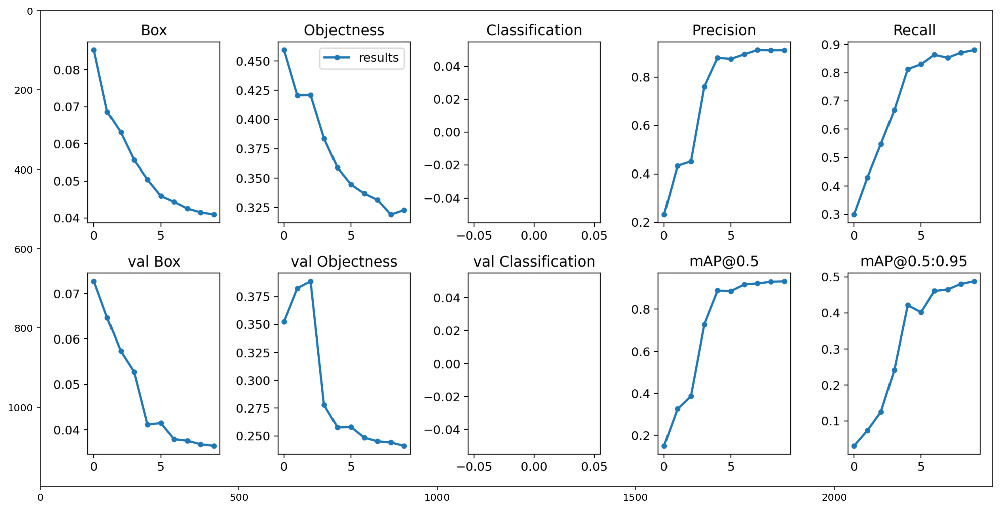

In [ ]:
show_single('/content/drive/MyDrive/DL_project/Dataset/kaggle-global-wheat-detection/yolov5/runs/train/wmv5x_noWeight_b4_ep10/results.png')

In [ ]:
!python detect.py --img 1024 --weights runs/train/wmv5x_noWeight_b4_ep10/weights/best.pt \
 --source wheat_data/test --conf-thres 0.40 --save-txt --save-conf --augment --name model2Detect_augument

detect: weights=['runs/train/wmv5x_noWeight_b4_ep10/weights/best.pt'], source=wheat_data/test, imgsz=1024, conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_conf=True, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=True, update=False, project=runs/detect, name=model2Detect_augument, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False
YOLOv5 🚀 v5.0-228-gae4261c torch 1.9.0+cu102 CUDA:0 (Tesla T4, 15109.75MB)

Fusing layers... 
Model Summary: 476 layers, 87198694 parameters, 0 gradients
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)
image 1/10

In [ ]:
!python test.py --weights runs/train/wmv5x_noWeight_b4_ep10/weights/best.pt --data wheat.yml --img 1024  --save-json --conf-thres 0.4 --single-cls --save-conf

test: data=wheat.yml, weights=['runs/train/wmv5x_noWeight_b4_ep10/weights/best.pt'], batch_size=32, imgsz=1024, conf_thres=0.4, iou_thres=0.6, task=val, device=, single_cls=True, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=True, save_json=True, project=runs/test, name=exp, exist_ok=False, half=False
YOLOv5 🚀 2021-6-23 torch 1.9.0+cu102 CUDA:0 (Tesla T4, 15109.75MB)

Fusing layers... 
Model Summary: 476 layers, 87198694 parameters, 0 gradients
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)
val: Scanning 'wheat_data/labels/validation.cache' images and labels... 338 found, 0 missing, 0 empty, 0 corrupted: 10

### Training round 3 with yolov5m

In [ ]:
!ls

apex		 Dockerfile  __pycache__       test.py	       wandb
CONTRIBUTING.md  hubconf.py  README.md	       train.py        wheat_data
data		 LICENSE     requirements.txt  tutorial.ipynb  wheat.yml
detect.py	 models      runs	       utils	       yolov5x.pt


In [ ]:
!python train.py --img 1024 --batch 4 --epochs 10 \
  --data wheat.yml --cfg models/yolov5m.yaml --weights '' \
  --name wmv5m_noWeight_b4_ep10

train: weights=, cfg=models/yolov5m.yaml, data=wheat.yml, hyp=data/hyp.scratch.yaml, epochs=10, batch_size=4, img_size=[1024], rect=False, resume=False, nosave=False, notest=False, noautoanchor=False, evolve=False, bucket=, cache_images=False, image_weights=False, device=, multi_scale=False, single_cls=False, adam=False, sync_bn=False, workers=8, project=runs/train, entity=None, name=wmv5m_noWeight_b4_ep10, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, upload_dataset=False, bbox_interval=-1, save_period=-1, artifact_alias=latest, local_rank=-1
github: ⚠️ WARNING: code is out of date by 12 commits. Use 'git pull' to update or 'git clone https://github.com/ultralytics/yolov5' to download latest.
YOLOv5 🚀 2021-6-19 torch 1.9.0+cu102 CUDA:0 (Tesla T4, 15109.75MB)

hyperparameters: lr0=0.01, lrf=0.2, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0,

In [ ]:
!python train.py --img 1024 --batch 8 --epochs 10 \
  --data wheat.yml --cfg models/yolov5m.yaml --weights '' \
  --name wmv5m_noWeight_b8_ep10

train: weights=, cfg=models/yolov5m.yaml, data=wheat.yml, hyp=data/hyps/hyp.scratch.yaml, epochs=10, batch_size=8, img_size=[1024], rect=False, resume=False, nosave=False, notest=False, noautoanchor=False, evolve=False, bucket=, cache_images=False, image_weights=False, device=, multi_scale=False, single_cls=False, adam=False, sync_bn=False, workers=8, project=runs/train, entity=None, name=wmv5m_noWeight_b8_ep10, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, upload_dataset=False, bbox_interval=-1, save_period=-1, artifact_alias=latest, local_rank=-1
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v5.0-228-gae4261c torch 1.9.0+cu102 CUDA:0 (Tesla T4, 15109.75MB)

hyperparameters: lr0=0.01, lrf=0.2, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, degrees=0.0, translate=0.1

In [ ]:
!python detect.py --img 1024 --weights runs/train/wmv5m_noWeight_b8_ep102/weights/best.pt \
 --source wheat_data/test --conf-thres 0.40 --save-txt --save-conf --augment --name model3Detect_augument

detect: weights=['runs/train/wmv5m_noWeight_b8_ep102/weights/best.pt'], source=wheat_data/test, imgsz=1024, conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_conf=True, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=True, update=False, project=runs/detect, name=model3Detect_augument, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False
YOLOv5 🚀 v5.0-228-gae4261c torch 1.9.0+cu102 CUDA:0 (Tesla T4, 15109.75MB)

Fusing layers... 
Model Summary: 308 layers, 21037638 parameters, 0 gradients
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)
image 1/1

### Training rond 4 on 20-80 split with weights yolov5x

In [ ]:
%cd /content/drive/MyDrive/DL_project/Dataset/kaggle-global-wheat-detection/yolov5

/content/drive/.shortcut-targets-by-id/1ubUpzvJcPMrTajuknokg-YOA-OhqpgTu/DL_project/Dataset/kaggle-global-wheat-detection/yolov5


In [ ]:
!python train.py --img 1024 --batch 4 --epochs 10 \
  --data wheat20_80.yml --cfg models/yolov5x.yaml --weights yolov5x.pt \
  --name wm_s20_80

train: weights=yolov5x.pt, cfg=models/yolov5x.yaml, data=wheat20_80.yml, hyp=data/hyps/hyp.scratch.yaml, epochs=10, batch_size=4, img_size=[1024], rect=False, resume=False, nosave=False, notest=False, noautoanchor=False, evolve=False, bucket=, cache_images=False, image_weights=False, device=, multi_scale=False, single_cls=False, adam=False, sync_bn=False, workers=8, project=runs/train, entity=None, name=wm_s20_80, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, upload_dataset=False, bbox_interval=-1, save_period=-1, artifact_alias=latest, local_rank=-1
github: Command 'git fetch && git config --get remote.origin.url' timed out after 5 seconds, for updates see https://github.com/ultralytics/yolov5
YOLOv5 🚀 v5.0-228-gae4261c torch 1.9.0+cu102 CUDA:0 (Tesla T4, 15109.75MB)

hyperparameters: lr0=0.01, lrf=0.2, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anch

In [ ]:
!python detect.py --img 1024 --weights runs/train/wm_s20_8010/weights/best.pt \
 --source wheat_data/test --conf-thres 0.40 --save-txt --save-conf --augment --name model4Detect_augument

detect: weights=['runs/train/wm_s20_8010/weights/best.pt'], source=wheat_data/test, imgsz=1024, conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_conf=True, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=True, update=False, project=runs/detect, name=model4Detect_augument, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False
YOLOv5 🚀 v5.0-228-gae4261c torch 1.9.0+cu102 CUDA:0 (Tesla T4, 15109.75MB)

Fusing layers... 
Model Summary: 476 layers, 87198694 parameters, 0 gradients
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)
image 1/10 /content/d

In [ ]:
!python detect.py --img 1024 --weights runs/train/wm_s20_8010/weights/best.pt \
 --source wheat_data/test2 --save-txt --save-conf --augment --name model4on_newData

detect: weights=['runs/train/wm_s20_8010/weights/best.pt'], source=wheat_data/test2, imgsz=1024, conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_conf=True, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=True, update=False, project=runs/detect, name=model4on_newData, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False
YOLOv5 🚀 v5.0-228-gae4261c torch 1.9.0+cu102 CUDA:0 (Tesla T4, 15109.75MB)

Fusing layers... 
Model Summary: 476 layers, 87198694 parameters, 0 gradients
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)
image 1/2 /content/drive

In [ ]:
!python test.py --weights runs/train/wm_s20_8010/weights/best.pt --data wheat20_80.yml --img 1024  --save-json --conf-thres 0.4 --single-cls --save-conf

test: data=wheat20_80.yml, weights=['runs/train/wm_s20_8010/weights/best.pt'], batch_size=32, imgsz=1024, conf_thres=0.4, iou_thres=0.6, task=val, device=, single_cls=True, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=True, save_json=True, project=runs/test, name=exp, exist_ok=False, half=False
YOLOv5 🚀 2021-6-23 torch 1.9.0+cu102 CUDA:0 (Tesla T4, 15109.75MB)

Fusing layers... 
Model Summary: 476 layers, 87198694 parameters, 0 gradients
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)
val: Scanning 'wd_20_80/labels/validation.cache' images and labels... 675 found, 0 missing, 0 empty, 0 corrupted: 100% 675/6

### Traing round 5 
 

1.   split 20 80
2.   no weights
batch 4 epoch 10



In [ ]:
!python train.py --img 1024 --batch 4 --epochs 10 \
  --data wheat20_80.yml --cfg models/yolov5x.yaml --weights '' \
  --name wm_s20_80_no_weight

train: weights=, cfg=models/yolov5x.yaml, data=wheat20_80.yml, hyp=data/hyps/hyp.scratch.yaml, epochs=10, batch_size=4, img_size=[1024], rect=False, resume=False, nosave=False, notest=False, noautoanchor=False, evolve=False, bucket=, cache_images=False, image_weights=False, device=, multi_scale=False, single_cls=False, adam=False, sync_bn=False, workers=8, project=runs/train, entity=None, name=wm_s20_80_no_weight, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, upload_dataset=False, bbox_interval=-1, save_period=-1, artifact_alias=latest, local_rank=-1
github: ⚠️ WARNING: code is out of date by 8 commits. Use 'git pull' to update or 'git clone https://github.com/ultralytics/yolov5' to download latest.
YOLOv5 🚀 2021-6-23 torch 1.9.0+cu102 CUDA:0 (Tesla T4, 15109.75MB)

hyperparameters: lr0=0.01, lrf=0.2, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_

In [ ]:
!python detect.py --img 1024 --weights runs/train/wm_s20_80_no_weight/weights/best.pt \
 --source wheat_data/test --conf-thres 0.40 --save-txt --save-conf --augment --name model5Detect_augument

In [ ]:
!rm -r runs/detect/model4Detect_augument2

### submission

In [ ]:
def format_prediction_string(df):
    pred_strings = []
    for i,j in df.iterrows():
        pred_strings.append("{0:.6f} {1:.6f} {2:.6f} {3:.6f} {4:.6f}".format(j['score'], j['x'], j['y'], j['h'], j['w']))

    return " ".join(pred_strings)

In [ ]:
def get_results(path):
  file_list =  os.listdir(path)
  results = []
  for l in file_list:
    image_id = l.split('.')[0]
    df = pd.read_csv(os.path.join(path,l), sep=' ', header=None, names=['class','x','y','h','w','score'])
    df.x = df.x.multiply(1024)
    df.y = df.y.multiply(1024)
    df.h = df.h.multiply(1024)
    df.w = df.w.multiply(1024)
    result = {
              'image_id': image_id,
              'PredictionString': format_prediction_string(df)
          }
    results.append(result)
  return results


In [ ]:
def to_submission(path,save_nam):
  results = get_results(path)
  test_df = pd.DataFrame(results, columns=['image_id', 'PredictionString'])
  test_df.to_csv(save_nam, index=False)

In [ ]:
path = '/content/drive/MyDrive/DL_project/Dataset/kaggle-global-wheat-detection/yolov5/runs/detect/model4Detect_augument/labels'
to_submission(path,'submission_4aug.csv')

In [ ]:
!mv /content/submission_5aug.csv /content/drive/MyDrive/DL_project/Dataset/kaggle-global-wheat-detection/yolov5/submission

In [ ]:
%cd /content/drive/MyDrive/DL_project/Dataset/kaggle-global-wheat-detection/yolov5

/content/drive/.shortcut-targets-by-id/1ubUpzvJcPMrTajuknokg-YOA-OhqpgTu/DL_project/Dataset/kaggle-global-wheat-detection/yolov5


## Demo

In [14]:
%cd /content/drive/MyDrive/DL_project/Dataset/kaggle-global-wheat-detection/yolov5

/content/drive/MyDrive/DL_project/Dataset/kaggle-global-wheat-detection/yolov5


In [15]:
def resize(path):
  dirs = os.listdir(path)
  new_dir = os.path.join(path,'resized')
  os.mkdir(new_dir)
  for item in dirs:
    file_path=os.path.join(path,item)
    new_file_path=os.path.join(new_dir,item)
    if os.path.isfile(file_path):
      im = Image.open(file_path)
      f, e = os.path.splitext(new_file_path)
      imResize = im.resize((1024,1024), Image.ANTIALIAS)
      imResize.save(f + ' resized.jpg', 'JPEG')
      # print(f,e)


In [16]:
path = '/content/drive/MyDrive/DL_project/Dataset/kaggle-global-wheat-detection/yolov5/demo'
# resize(path)

In [17]:
!python detect.py --img 1024 --weights runs/train/wheat_model7/weights/best.pt \
 --source demo --name demo

detect: weights=['runs/train/wheat_model7/weights/best.pt'], source=demo, imgsz=1024, conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, update=False, project=runs/detect, name=demo, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False
YOLOv5 🚀 v5.0-228-gae4261c torch 1.9.0+cu102 CUDA:0 (Tesla P4, 7611.9375MB)

Fusing layers... 
Model Summary: 476 layers, 87198694 parameters, 0 gradients
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)
image 1/3 /content/drive/MyDrive/DL_project

In [18]:
# from IPython.display import Image, clear_output
# Image(filename='runs/detect/demo1/wheat-grain-crops-bread.jpg', width=500)

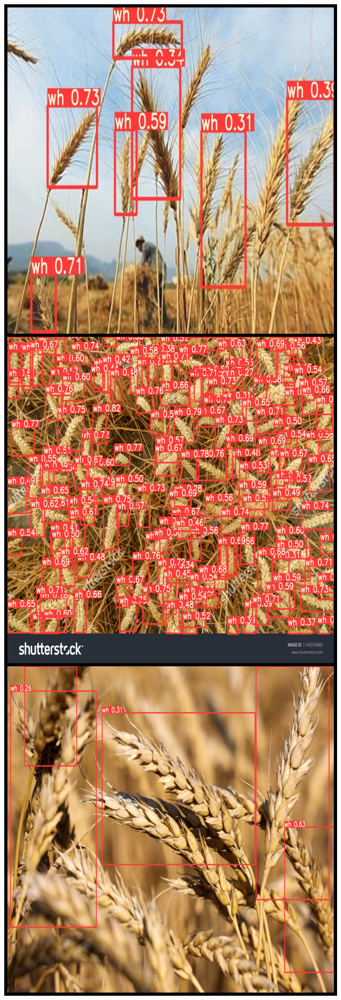

In [19]:
img_paths = list(Path("/content/drive/MyDrive/DL_project/Dataset/kaggle-global-wheat-detection/yolov5/runs/detect/demo").glob("*.jpg"))
show_grid(img_paths)